# <font color='purple'>NIH d8 Preprocessing QC statistics </font> 
### December 2024

In [1]:
import os
# NOVA_HOME = '/home/labs/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps'
NOVA_HOME = "/home/labs/hornsteinlab/Collaboration/NOVA_GAL/NOVA"
NOVA_DATA_HOME = '/home/labs/hornsteinlab/Collaboration/MOmaps'

# LOGS_PATH = os.path.join(NOVA_DATA_HOME, "outputs/preprocessing/AlyssaCoyne/logs/preprocessing_CoyneLab_iPSC_patients_TDP43_PB_7tiles/")
# PLOT_PATH = os.path.join(NOVA_DATA_HOME, "outputs/preprocessing/AlyssaCoyne/logs/preprocessing_CoyneLab_iPSC_patients_TDP43_PB_7tiles/plots")
LOGS_PATH = os.path.join(NOVA_DATA_HOME, "outputs/preprocessing/NIH/logs/")
PLOT_PATH = os.path.join(NOVA_DATA_HOME, "outputs/NIH/logs/")


os.chdir(NOVA_HOME)

import pandas as pd
import contextlib
import io
from IPython.display import display, Javascript
import seaborn as sns
from tools.preprocessing_tools.qc_reports.qc_utils import log_files_qc, run_validate_folder_structure, display_diff, sample_and_calc_variance, \
                                                show_site_survival_dapi_brenner, show_site_survival_dapi_cellpose, \
                                                show_site_survival_dapi_tiling, show_site_survival_target_brenner, \
                                                calc_total_sums, plot_filtering_heatmap, show_total_sum_tables, \
                                                plot_cell_count, plot_catplot, plot_hm_combine_batches, plot_hm, \
                                                run_calc_hist_new
                                                
from tools.preprocessing_tools.qc_reports.qc_config import (
    NIH_markers as markers,
    NIH_cell_lines as cell_lines,
    NIH_cell_lines_to_cond as cell_lines_to_cond,
    NIH_cell_lines_for_disp as cell_lines_for_disp,
    NIH_reps as reps,
    NIH_line_colors as line_colors,
    NIH_lines_order as lines_order,
    NIH_custom_palette as custom_palette,
    NIH_expected_dapi_raw as expected_dapi_raw,
#     NIH_cell_lines_to_reps as cell_lines_to_reps,
    NIH_panels as panels,
    NIH_marker_info as marker_info
)

%load_ext autoreload
%autoreload 2

In [2]:
# choose batches
batches = ['batch1', 'batch2', 'batch3']
batches

['batch1', 'batch2', 'batch3']

I have created a folder called 'batch1' in the logs dir and put all files inside

In [3]:
validate_antibody = False

In [4]:
df = log_files_qc(LOGS_PATH, batches)

df_dapi = df[df.marker=='DAPI']
df_target = df[df.marker!='DAPI']

reading logs of batch1

Total of 1 files were read.
Before dup handeling  (124995, 21)
After duplication removal #1: (124995, 22)
After duplication removal #2: (124995, 22)


## Actual Files Validation

### Raw Files Validation

1. How many site **tiff** files do we have in each folder?
2. Are all existing files valid? (tif, at least 2049kB, not corrupetd)

In [5]:
root_directory_raw = os.path.join(NOVA_DATA_HOME, 'input', 'images', 'raw', 'Cory', 'indi-image-pilot-20241128')

batch1
Folder structure is valid.
No bad files are found.
Total Sites:  44000


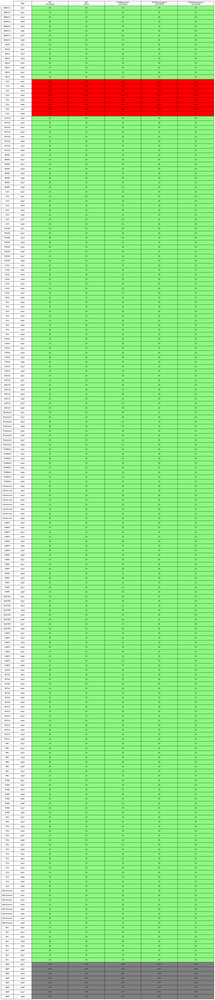

batch2
Folder structure is valid.
No bad files are found.
Total Sites:  44000


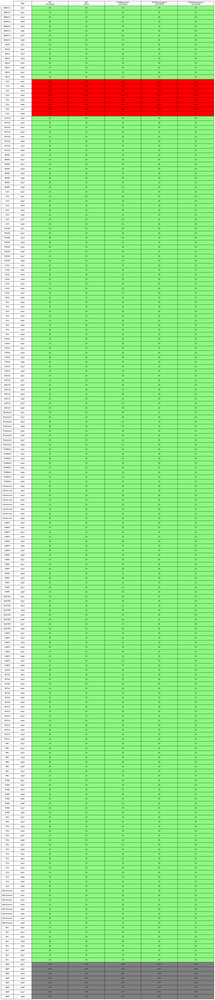

batch3
Folder structure is valid.
No bad files are found.
Total Sites:  44000


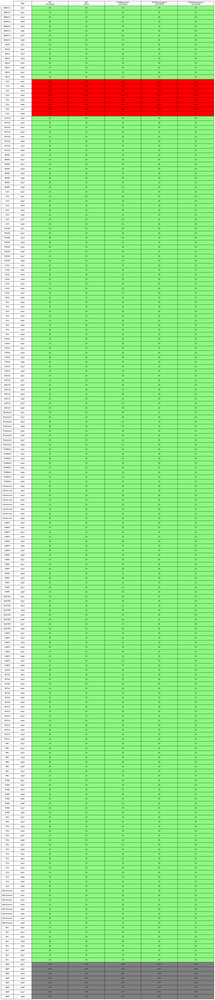

In [6]:
batches_raw = [batch.replace("_16bit_no_downsample","") for batch in batches]
raws = run_validate_folder_structure(root_directory_raw, False, panels, markers.copy(), PLOT_PATH, marker_info,
                                    cell_lines_to_cond, reps, cell_lines_for_disp, expected_dapi_raw,
                                     batches=batches_raw, fig_width=8,fig_height = 40,
                                    expected_count=25, validate_antibody = validate_antibody)

In [7]:
## Missing data issue was fixed

differences = (raws[0] != raws[1]).stack()
differences = differences[differences].index.to_frame(index=False)
differences.columns = ["Marker", "Rep", "Condition"]
for condition in differences["Condition"].unique():
    print(f"Condition: {condition}")
    condition_data = differences[differences["Condition"] == condition]
    for rep in condition_data["Rep"].unique():
        markers = condition_data[condition_data["Rep"] == rep]["Marker"].tolist()
        print(f"  Rep: {rep}")
        print(f"    Markers: {', '.join(markers)}")

### Processed Files Validation

1. How many site **npy** files do we have in each folder? -> How many sites survived the pre-processing?
2. Are all existing files valid? (at least 100kB, npy not corrupted)

batch1
Folder structure is valid.
No bad files are found.
Total Sites:  41554


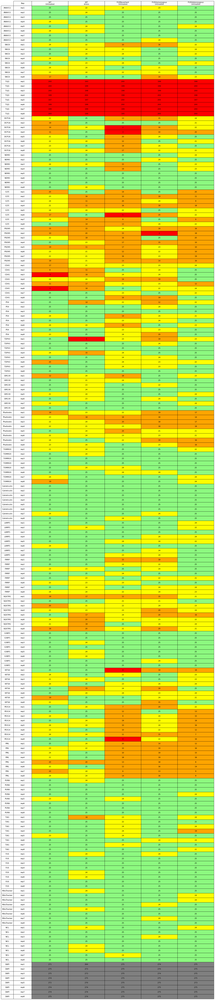

batch2
Folder structure is valid.
No bad files are found.
Total Sites:  41817


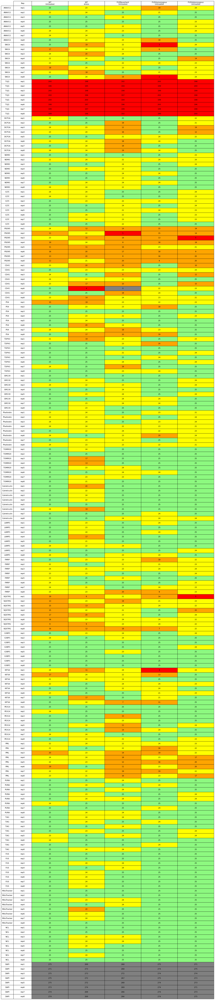

batch3
Folder structure is valid.
No bad files are found.
Total Sites:  41437


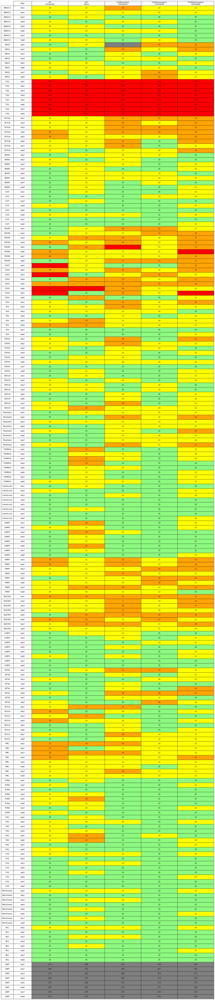

In [8]:
root_directory_proc = os.path.join(NOVA_DATA_HOME, 'input', 'images', 'processed', 'NIH')
procs = run_validate_folder_structure(root_directory_proc, True, panels, markers, PLOT_PATH, marker_info,
                                    cell_lines_to_cond, reps, cell_lines_for_disp, expected_dapi_raw,
                                     batches=batches, fig_width=8,fig_height = 40,
                                    expected_count=25, validate_antibody = validate_antibody)

### Difference between Raw and Processed

batch1


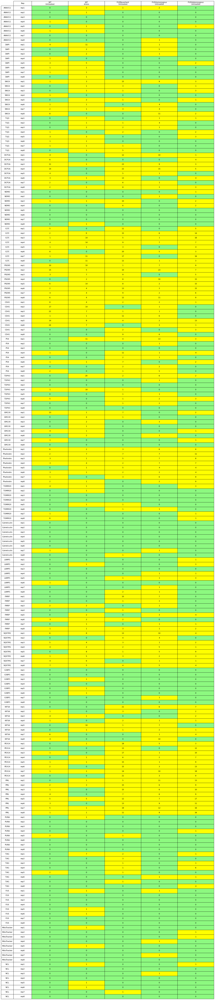

batch2


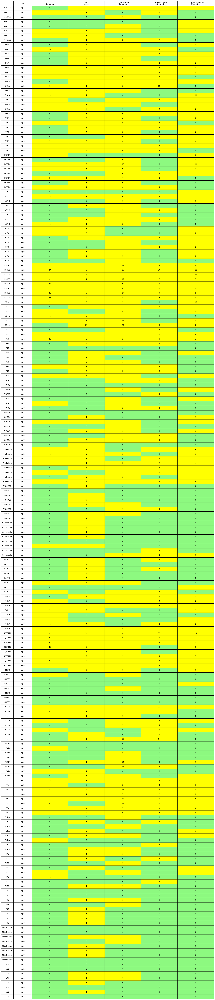

batch3


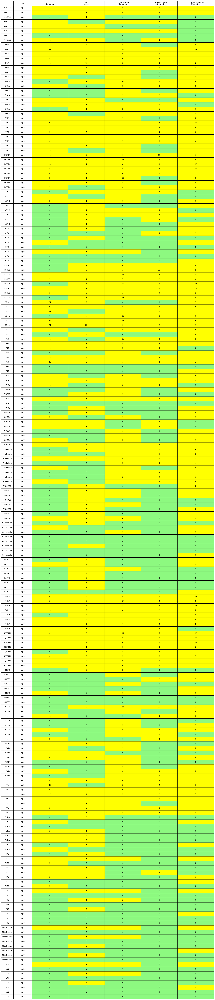

In [9]:
display_diff(batches, raws, procs, PLOT_PATH, fig_width=8, fig_height = 40)

### Variance in each batch (of processed files)

In [10]:
for batch in batches:
    with contextlib.redirect_stdout(io.StringIO()):
        var = sample_and_calc_variance(root_directory_proc, batch, 
                                       sample_size_per_markers=200, cond_count=1, rep_count=len(reps), 
                                       num_markers=len(markers))
    print(f'{batch} var: ',var)

batch1 var:  0.022988480343645326
batch2 var:  0.023757319703422954
batch3 var:  0.024366063156464356


## Preprocessing Filtering qc
By order of filtering

### 1. % site survival after Brenner on DAPI channel
Percentage out of the total sites

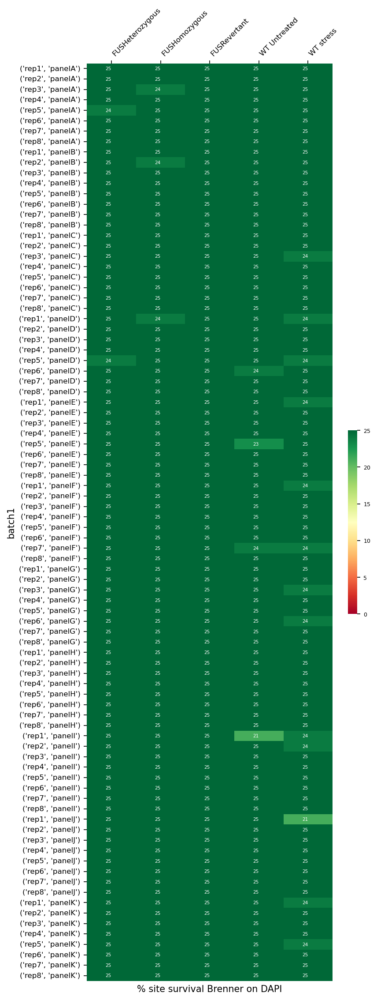

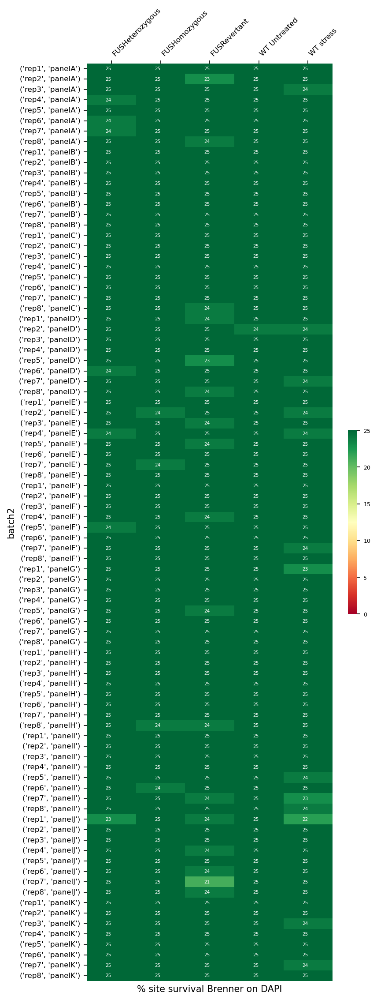

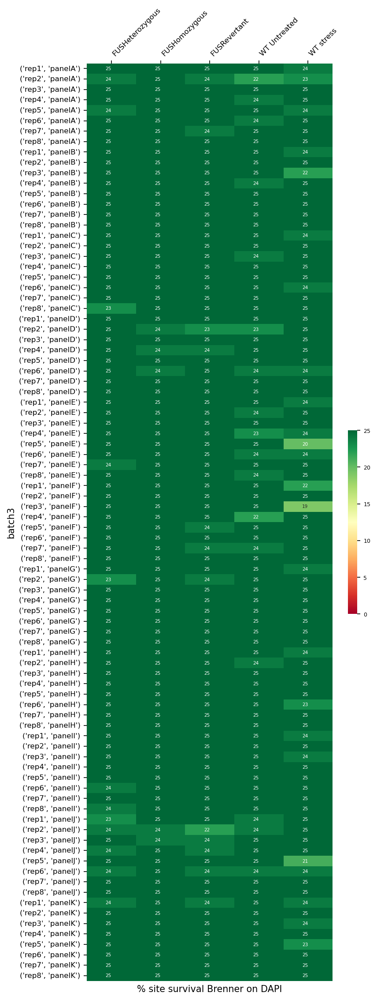

In [11]:
dapi_filter_by_brenner = show_site_survival_dapi_brenner(df_dapi,batches, line_colors, panels,
                                                        figsize=(6,18), reps=reps, vmax=25)

### 2. % Site survival after Cellpose
Percentage out of the sites that passed the previous filter. In parenthesis are absolute values.

**A site will be filtered out if Cellpose found 0 cells in it.**

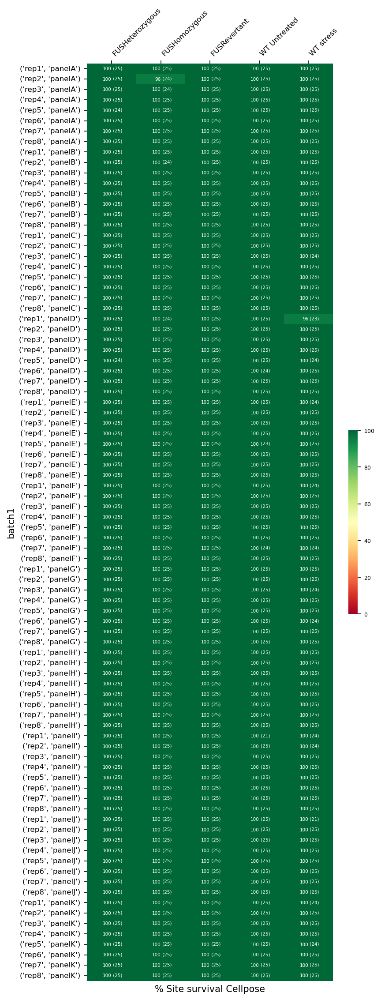

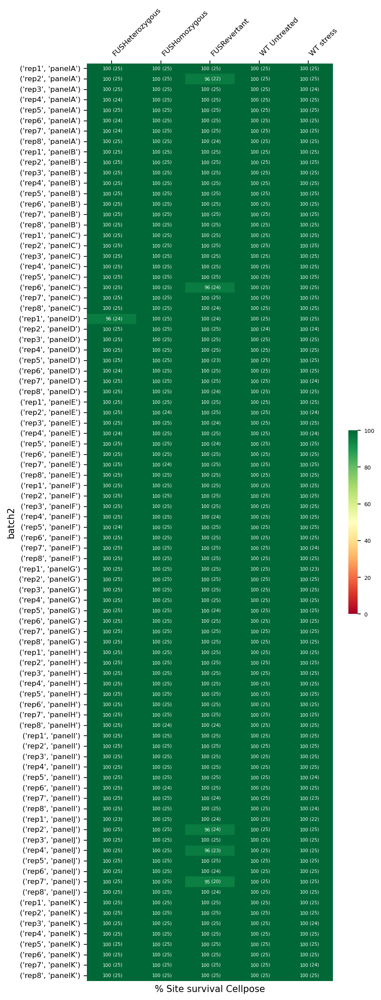

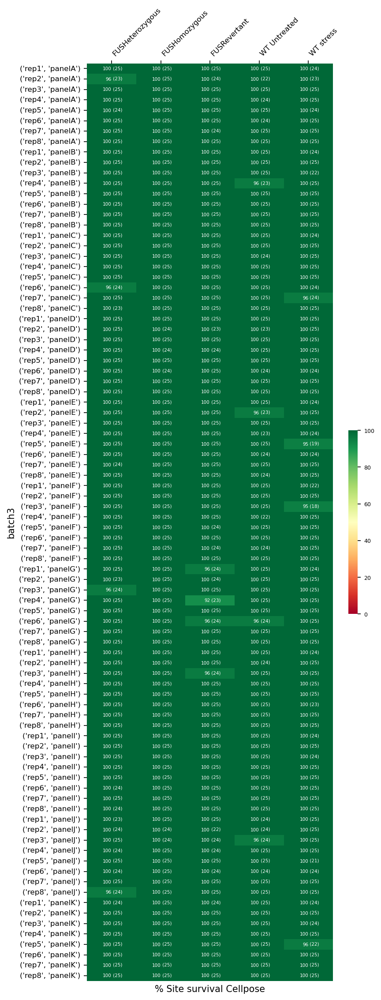

In [12]:
dapi_filter_by_cellpose = show_site_survival_dapi_cellpose(df_dapi, batches, dapi_filter_by_brenner, 
                                                           line_colors, panels, figsize=(6,18), reps=reps)

### 3. % Site survival by tiling
Percentage out of the sites that passed the previous filter. In parenthesis are absolute values.

**A site will be filtered out if after tiling, no tile is containing at least 85% of a cell that Cellpose detected.**

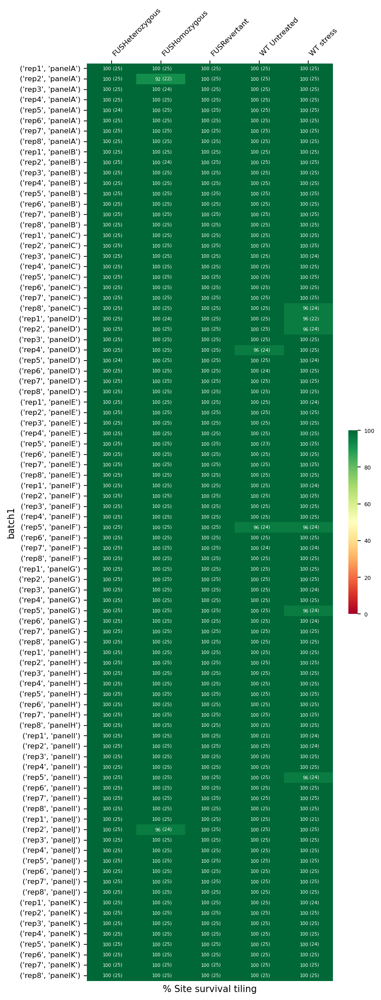

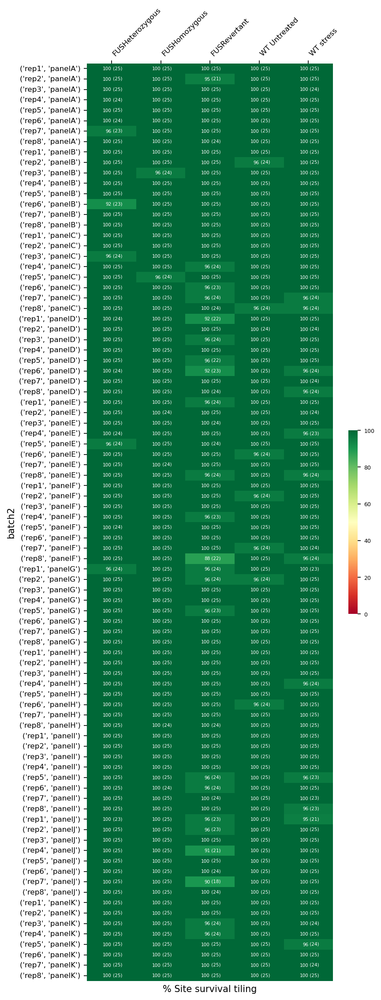

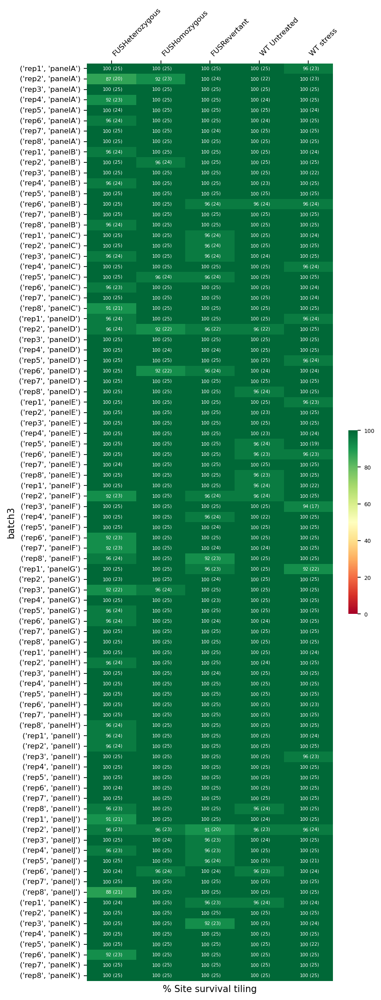

In [13]:
dapi_filter_by_tiling=show_site_survival_dapi_tiling(df_dapi, batches, dapi_filter_by_cellpose, 
                                                     line_colors, panels, figsize=(6,18), reps=reps)

### 4. % Site survival after Brenner on target channel
Percentage out of the sites that passed the previous filter. In parenthesis are absolute values (if different than the percentages).

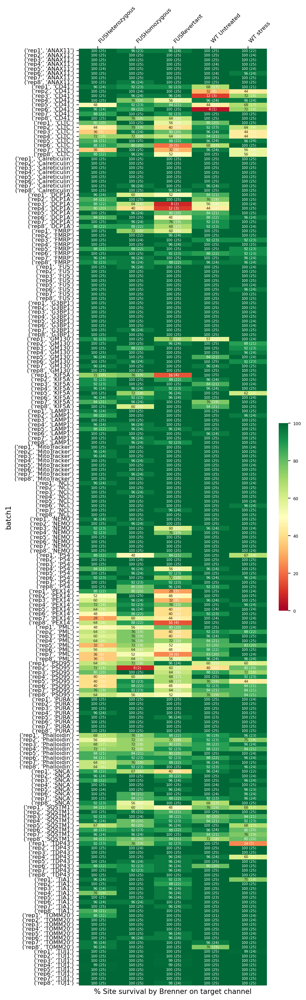

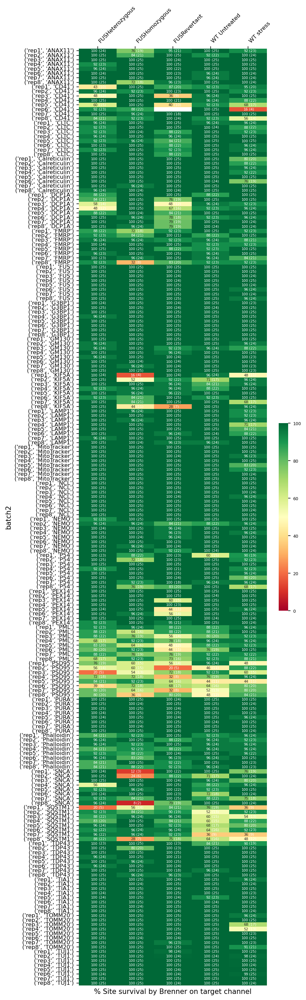

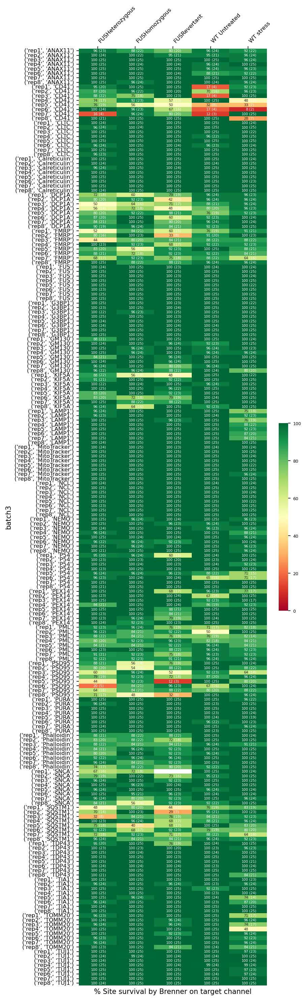

In [14]:
show_site_survival_target_brenner(df_dapi, df_target, dapi_filter_by_tiling,
                                 figsize=(6,24), markers=markers)

## Statistics About the Processed Files

In [45]:
names = ['Total number of tiles', 'Total number of whole cells']
stats = ['n_valid_tiles','site_whole_cells_counts_sum','site_cell_count','site_cell_count_sum']
total_sum = calc_total_sums(df_target, df_dapi, stats, markers)

In [55]:
import matplotlib.pyplot as plt
import seaborn as sns

def plot_marker_data(total_sum, split_by_cell_line=True):
    """
    Plot total valid tiles by batch for DAPI, TUJ1, and other markers.

    Parameters:
        total_sum (DataFrame): Original DataFrame containing marker data.
        split_by_cell_line (bool): Whether to plot for each cell_line_cond separately or all together.
    """
    if total_sum.empty:
        print("The total_sum DataFrame is empty. Provide valid data for visualization.")
        return

    # Calculate marker_tile_summary
    marker_tile_summary = total_sum.groupby(['batch', 'marker', 'cell_line_cond'])['n_valid_tiles'].sum().reset_index()

    # Define subsets and plotting logic
    def plot_data(data, title_suffix):
        for markers, figsize in [(['DAPI', 'TUJ1'], (12, 4)), (None, (12, 8))]:
            subset = data[data['marker'].isin(markers)] if markers else data[~data['marker'].isin(['DAPI', 'TUJ1'])]
            if not subset.empty:
                plt.figure(figsize=figsize)
                sns.barplot(
                    data=subset,
                    y='marker',
                    x='n_valid_tiles',
                    hue='batch',
                    ci=None,
                    orient='h'
                )
                plt.title(f"Total Valid Tiles {title_suffix} ({'DAPI & TUJ1' if markers else 'Other Markers'})", fontsize=16)
                plt.xlabel('Total Valid Tiles', fontsize=14)
                plt.ylabel('Marker', fontsize=14)
                plt.legend(title='Batch', bbox_to_anchor=(1.05, 1), loc='upper left')
                plt.tight_layout()
                plt.show()

    # Plot all together or split by cell_line_cond
    if split_by_cell_line:
        for cell_line in marker_tile_summary['cell_line_cond'].unique():
            plot_data(marker_tile_summary[marker_tile_summary['cell_line_cond'] == cell_line], f"by Batch ({cell_line})")
    else:
        plot_data(marker_tile_summary, "by Batch (All Cell Lines)")

/tmp/ipykernel_802054/3842151883.py:25: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(


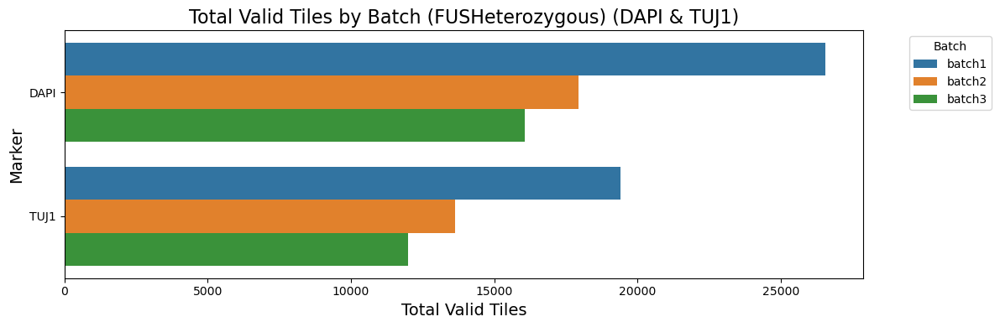

/tmp/ipykernel_802054/3842151883.py:25: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(


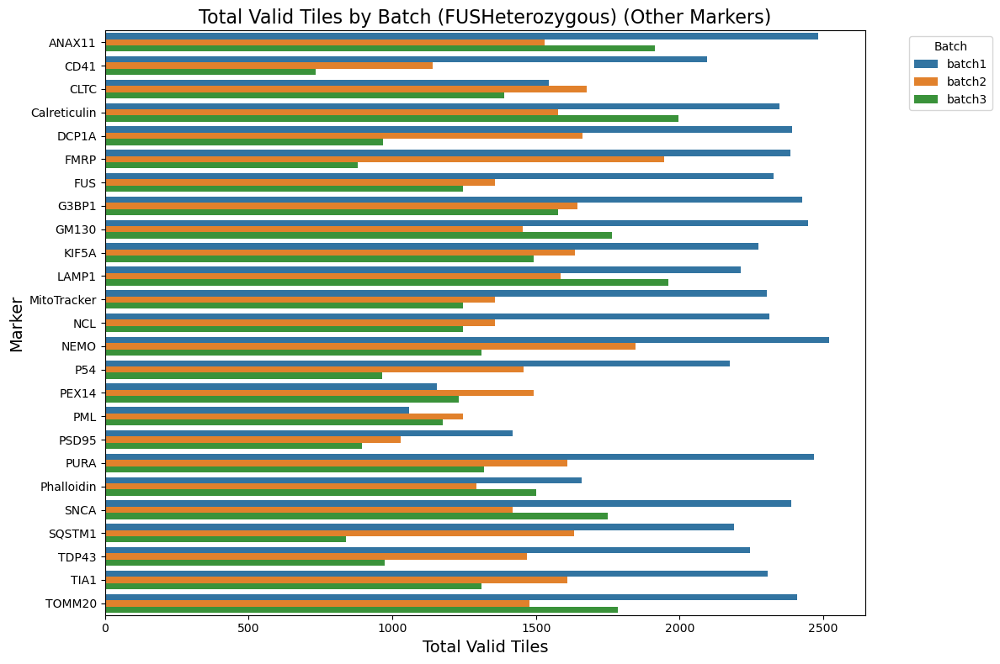

/tmp/ipykernel_802054/3842151883.py:25: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(


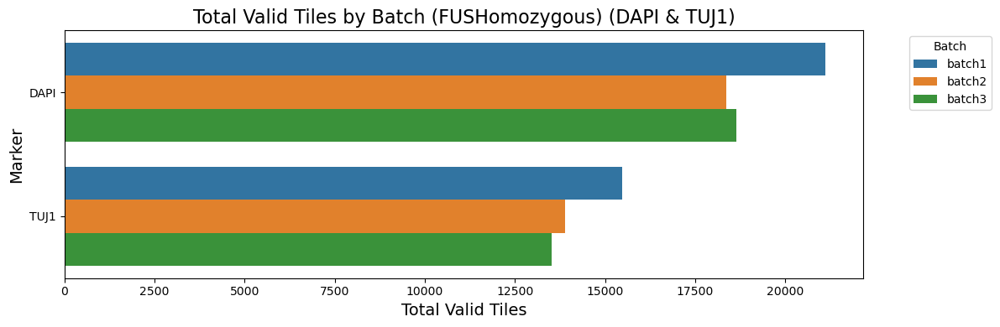

/tmp/ipykernel_802054/3842151883.py:25: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(


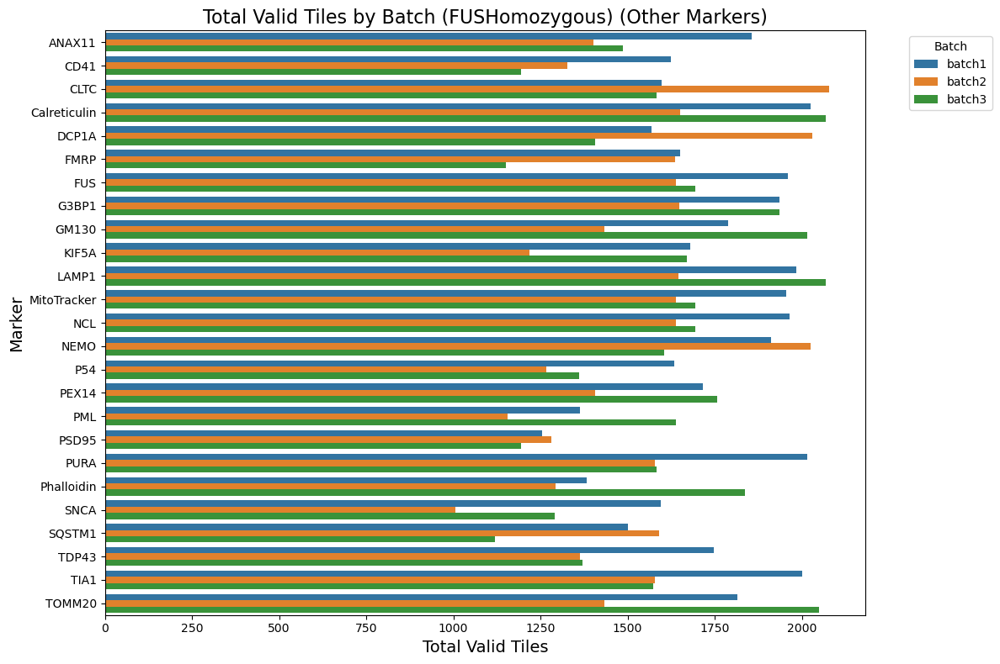

/tmp/ipykernel_802054/3842151883.py:25: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(


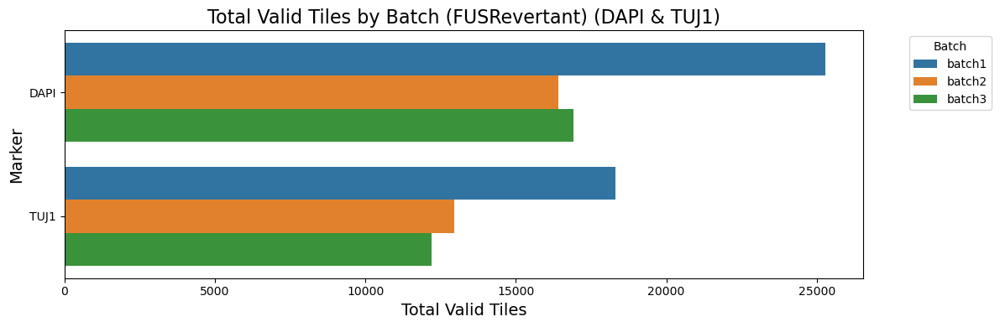

/tmp/ipykernel_802054/3842151883.py:25: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(


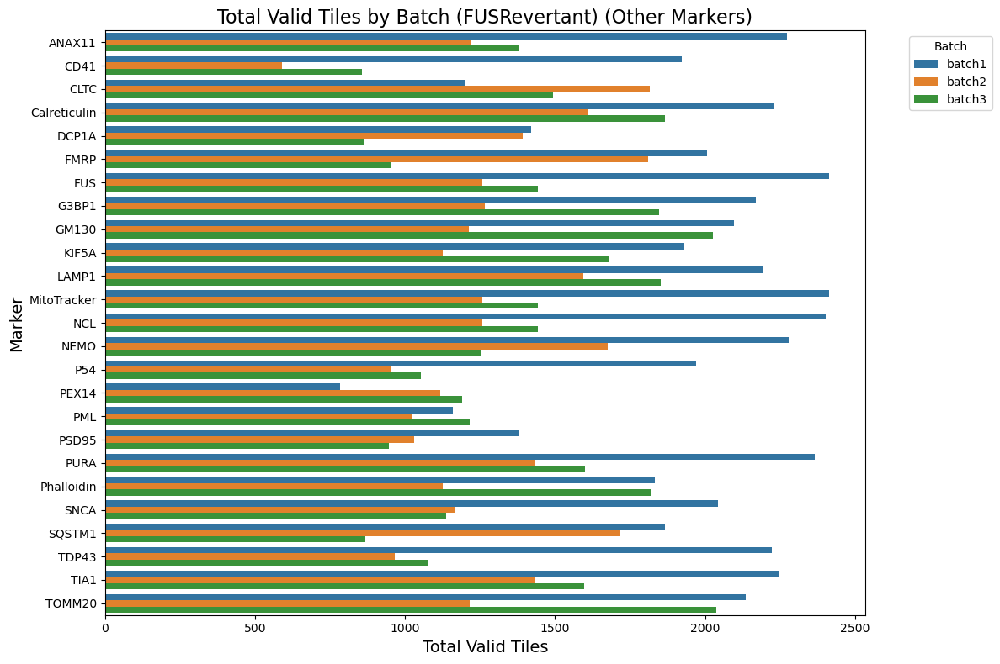

/tmp/ipykernel_802054/3842151883.py:25: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(


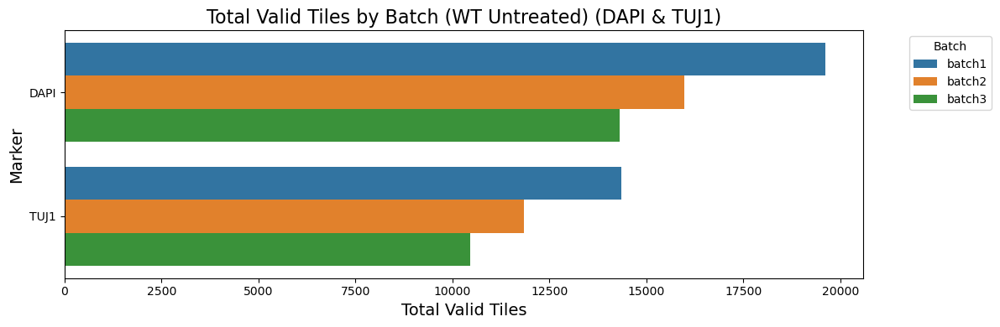

/tmp/ipykernel_802054/3842151883.py:25: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(


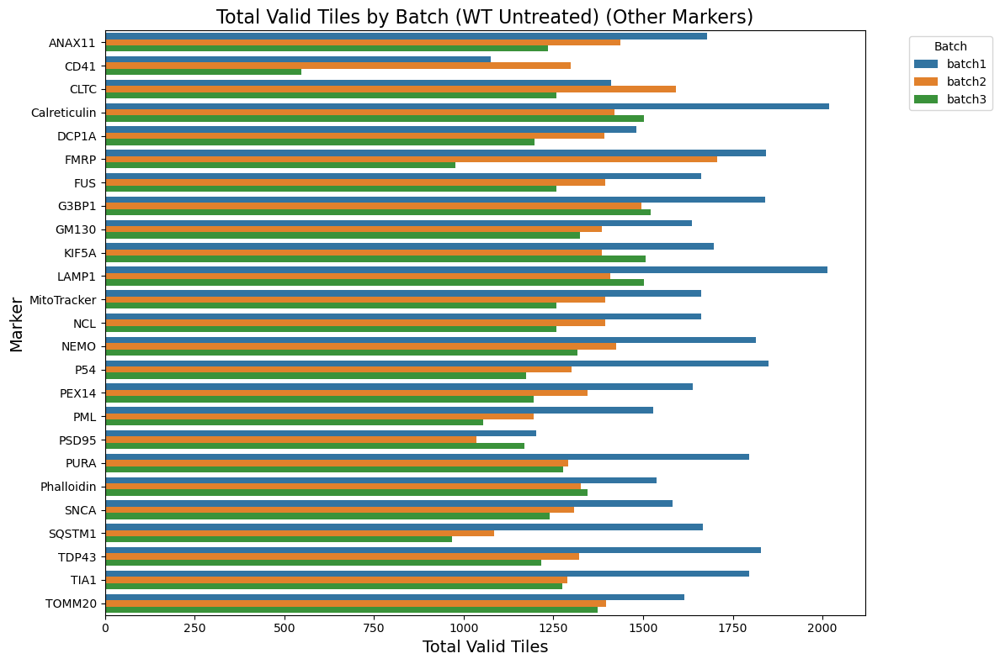

/tmp/ipykernel_802054/3842151883.py:25: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(


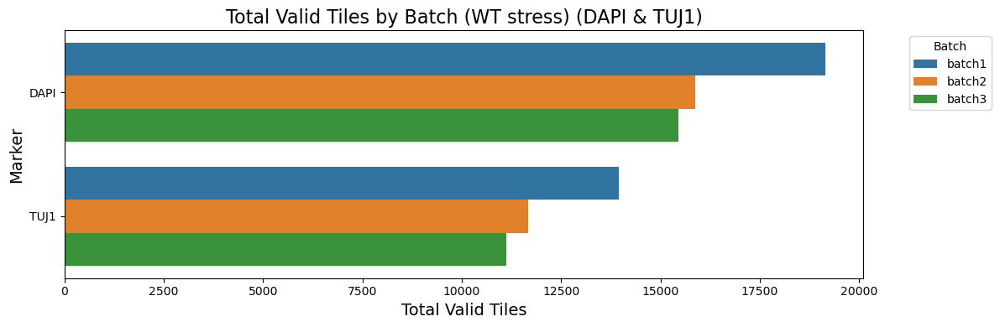

/tmp/ipykernel_802054/3842151883.py:25: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(


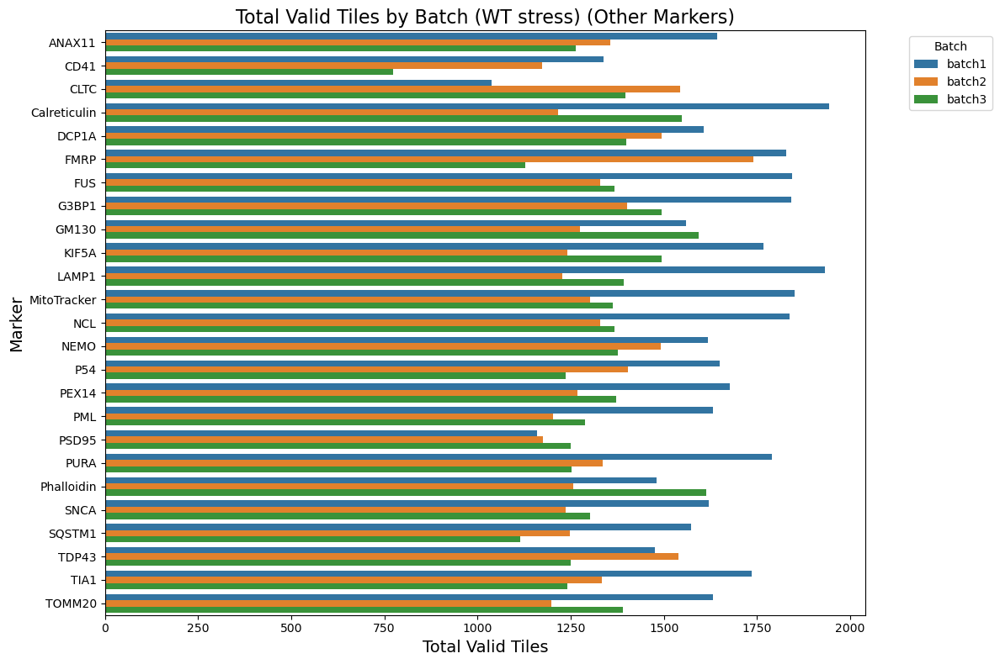

In [56]:
plot_marker_data(total_sum, split_by_cell_line=True)

/tmp/ipykernel_802054/3842151883.py:25: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(


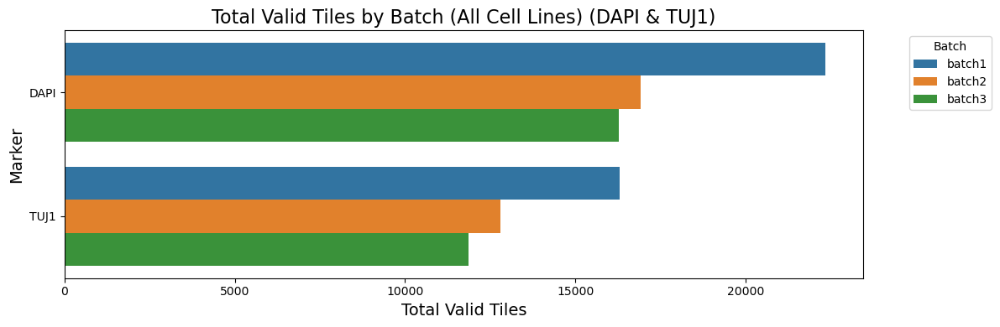

/tmp/ipykernel_802054/3842151883.py:25: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(


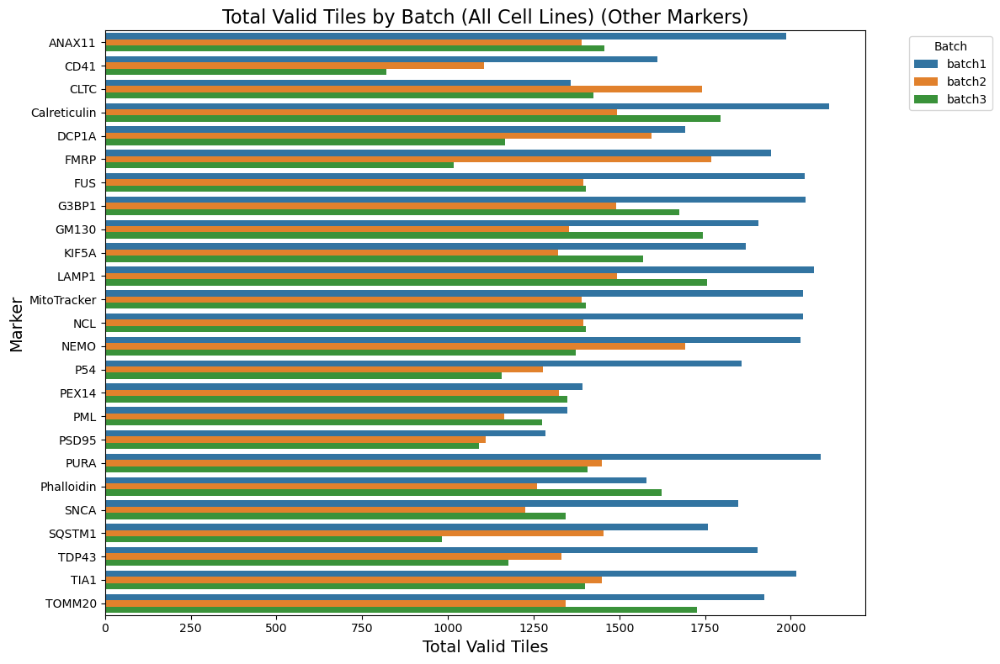

In [57]:
plot_marker_data(total_sum, split_by_cell_line=False)

### Total tiles

In [16]:
total_sum.n_valid_tiles.sum()

1058814

### Total whole nuclei in tiles

In [17]:
total_sum[total_sum.marker =='DAPI'].site_whole_cells_counts_sum.sum()

309500.0

### Total nuclei in sites

In [18]:
total_sum[total_sum.marker =='DAPI'].site_cell_count.sum()

987148.0

In [19]:
show_total_sum_tables(total_sum)

,n_valid_tiles,% valid tiles,site_whole_cells_counts_sum,site_cell_count
batch1,,,,
count,1760.000000,1760.000000,1760.000000,1.760000e+03
mean,239.684091,2.396841,271.938068,8.706875e+02
std,59.510808,0.595108,73.472260,2.129506e+02
min,13.000000,0.130000,16.000000,4.500000e+01
25%,202.000000,2.020000,224.000000,7.367500e+02
50%,239.000000,2.390000,268.000000,8.720000e+02
75%,281.000000,2.810000,324.250000,1.017000e+03
max,394.000000,3.940000,476.000000,1.583000e+03
sum,421844.000000,NaN,478611.000000,1.532410e+06


,n_valid_tiles,% valid tiles,site_whole_cells_counts_sum,site_cell_count
batch2,,,,
count,1759.000000,1759.000000,1759.000000,1.759000e+03
mean,183.982945,1.839829,202.681069,6.492638e+02
std,44.820712,0.448207,53.410873,1.702292e+02
min,11.000000,0.110000,12.000000,3.900000e+01
25%,156.000000,1.560000,170.000000,5.500000e+02
50%,181.000000,1.810000,197.000000,6.370000e+02
75%,208.000000,2.080000,229.500000,7.220000e+02
max,327.000000,3.270000,383.000000,1.279000e+03
sum,323626.000000,NaN,356516.000000,1.142055e+06


,n_valid_tiles,% valid tiles,site_whole_cells_counts_sum,site_cell_count
batch3,,,,
count,1759.000000,1759.000000,1759.000000,1.759000e+03
mean,178.137578,1.781376,195.906765,6.167078e+02
std,51.633657,0.516337,60.852536,1.862307e+02
min,8.000000,0.080000,10.000000,3.300000e+01
25%,144.000000,1.440000,155.500000,4.960000e+02
50%,178.000000,1.780000,194.000000,6.020000e+02
75%,206.000000,2.060000,226.000000,7.100000e+02
max,360.000000,3.600000,421.000000,1.200000e+03
sum,313344.000000,NaN,344600.000000,1.084789e+06


,n valid tiles,% valid tiles,site_whole_cells_counts_sum,site_cell_count
All batches,,,,
count,5.278000e+03,5278.000000,5.278000e+03,5.278000e+03
mean,2.006089e+02,2.006089,2.235178e+02,7.122497e+02
std,5.922536e+01,0.592254,7.186235e+01,2.214979e+02
min,8.000000e+00,0.080000,1.000000e+01,3.300000e+01
25%,1.610000e+02,1.610000,1.750000e+02,5.660000e+02
50%,1.950000e+02,1.950000,2.140000e+02,6.830000e+02
75%,2.350000e+02,2.350000,2.640000e+02,8.567500e+02
max,3.940000e+02,3.940000,4.760000e+02,1.583000e+03
sum,1.058814e+06,NaN,1.179727e+06,3.759254e+06


### Show Total Tile Counts
For each batch, cell line, replicate and markerTotal number of tiles

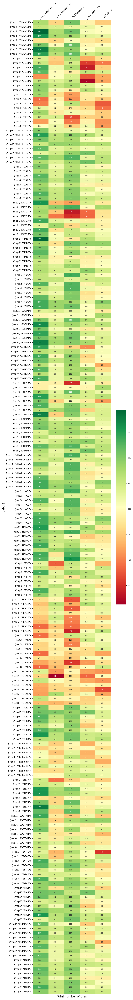

/home/labs/hornsteinlab/Collaboration/NOVA_GAL/NOVA/tools/preprocessing_tools/qc_reports/qc_utils.py:383: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=6)
/home/labs/hornsteinlab/Collaboration/NOVA_GAL/NOVA/tools/preprocessing_tools/qc_reports/qc_utils.py:383: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=6)


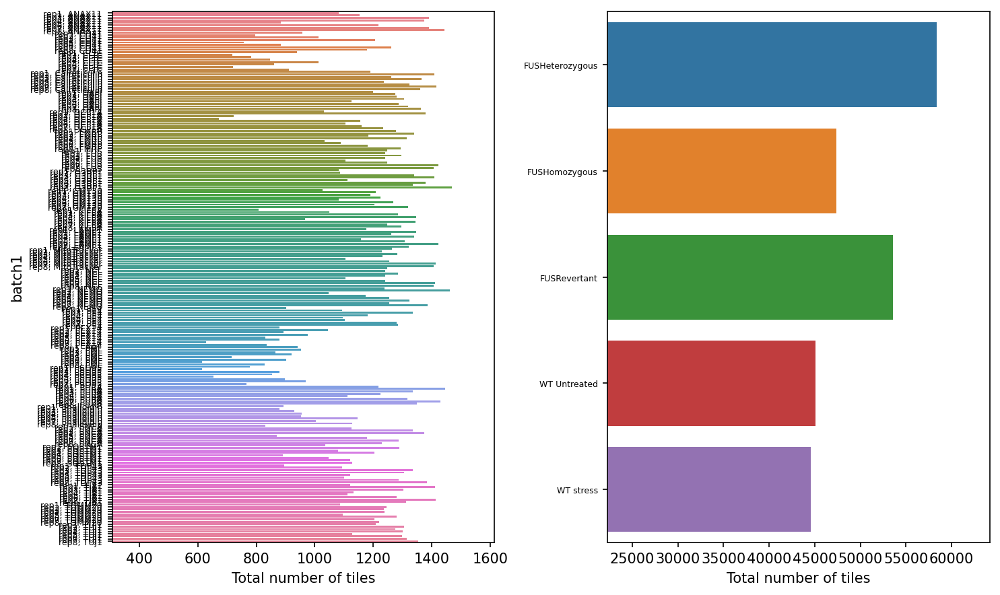

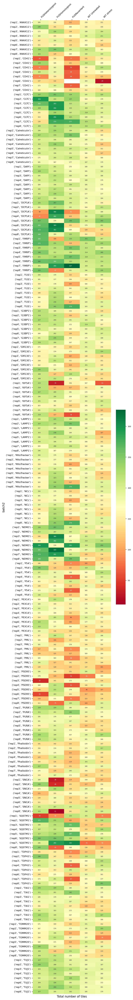

/home/labs/hornsteinlab/Collaboration/NOVA_GAL/NOVA/tools/preprocessing_tools/qc_reports/qc_utils.py:383: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=6)
/home/labs/hornsteinlab/Collaboration/NOVA_GAL/NOVA/tools/preprocessing_tools/qc_reports/qc_utils.py:383: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=6)


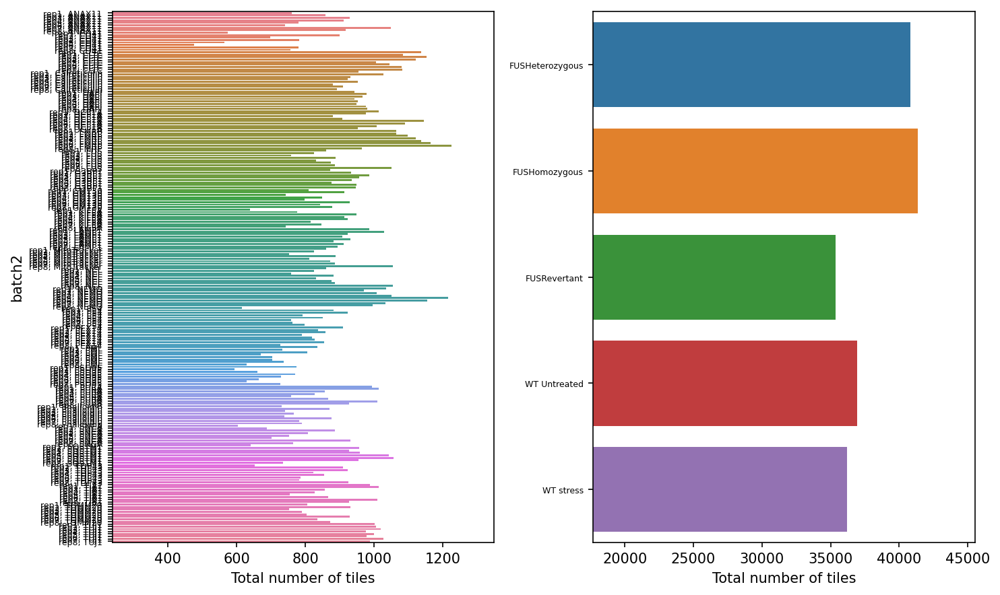

In [ ]:
to_heatmap = total_sum.rename(columns={'n_valid_tiles':'index'})
plot_filtering_heatmap(to_heatmap, extra_index='marker', vmin=None, vmax=None,
                      xlabel = 'Total number of tiles', show_sum=True, figsize=(6,60))

### Show Total Whole Cell Counts
For each batch, cell line, replicate and markerTotal number of tiles

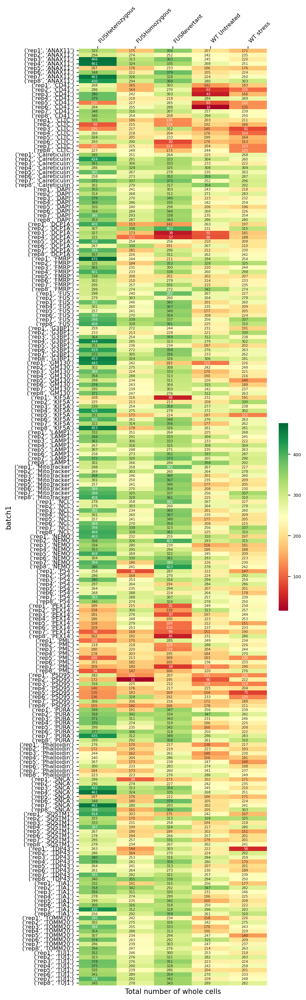

/home/labs/hornsteinlab/Collaboration/NOVA_GAL/NOVA/tools/preprocessing_tools/qc_reports/qc_utils.py:383: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xlabel(xlabel)
/home/labs/hornsteinlab/Collaboration/NOVA_GAL/NOVA/tools/preprocessing_tools/qc_reports/qc_utils.py:383: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xlabel(xlabel)


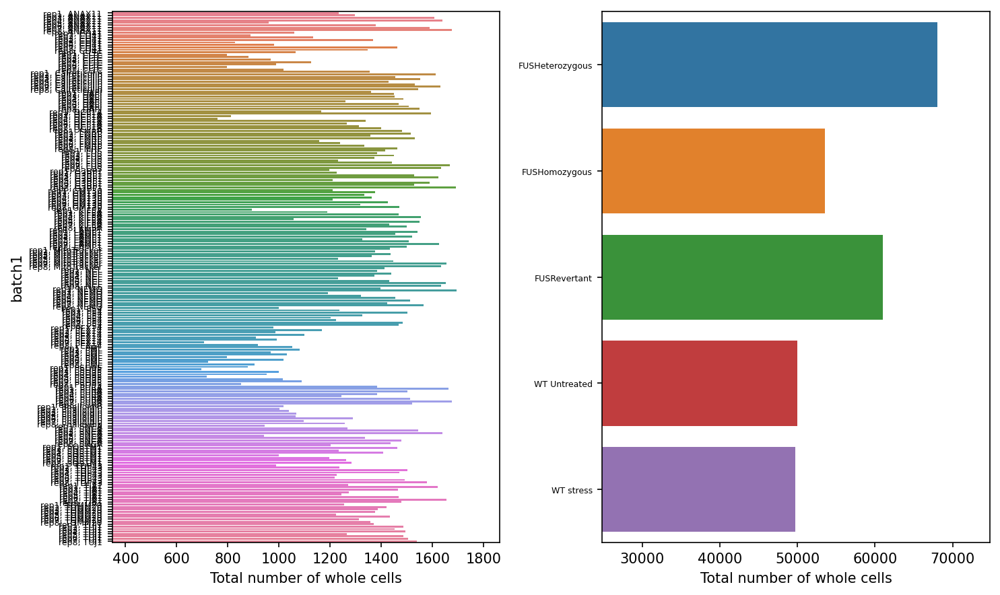

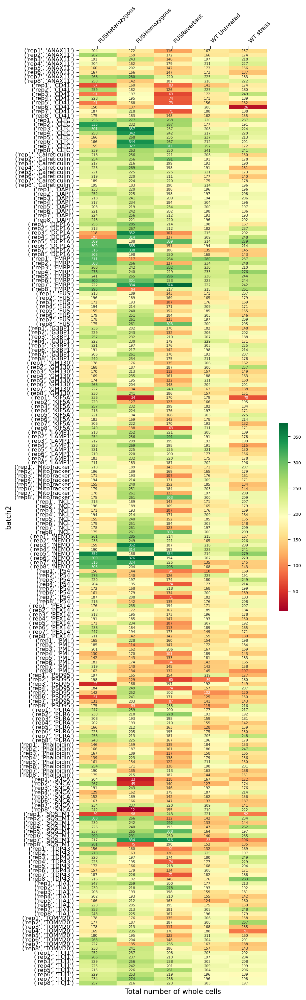

/home/labs/hornsteinlab/Collaboration/NOVA_GAL/NOVA/tools/preprocessing_tools/qc_reports/qc_utils.py:383: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xlabel(xlabel)
/home/labs/hornsteinlab/Collaboration/NOVA_GAL/NOVA/tools/preprocessing_tools/qc_reports/qc_utils.py:383: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xlabel(xlabel)


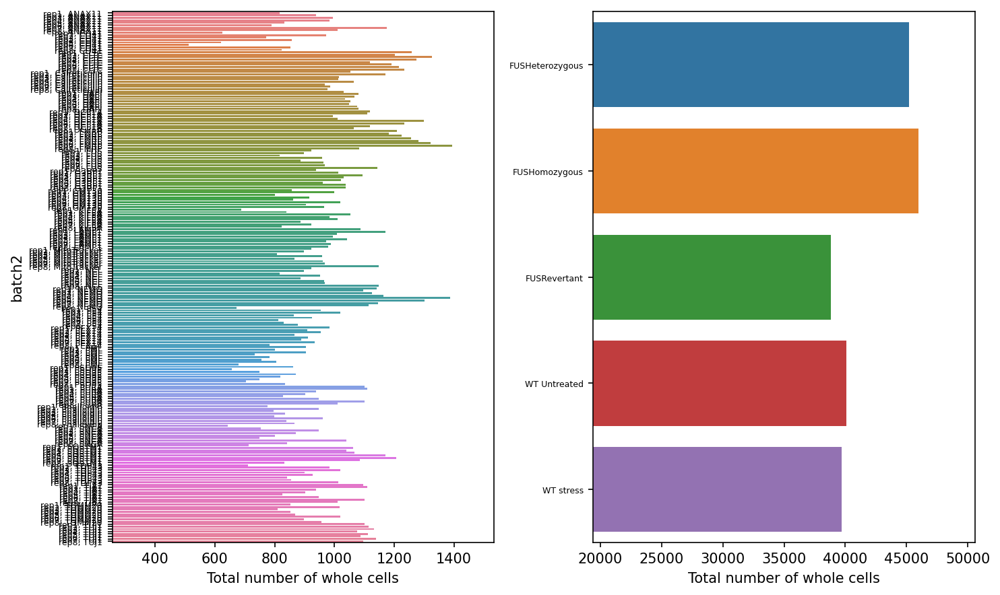

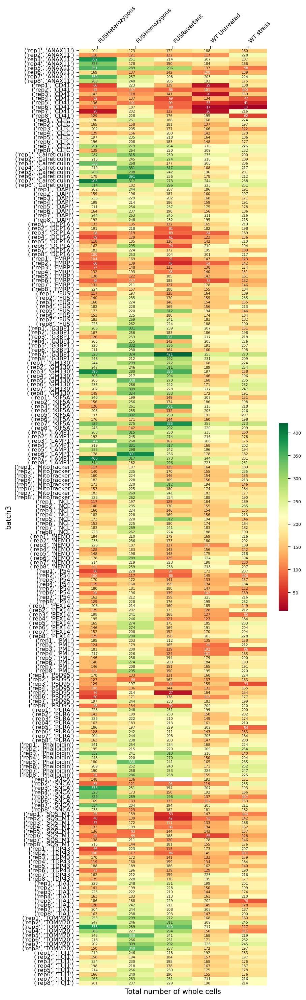

/home/labs/hornsteinlab/Collaboration/NOVA_GAL/NOVA/tools/preprocessing_tools/qc_reports/qc_utils.py:383: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xlabel(xlabel)
/home/labs/hornsteinlab/Collaboration/NOVA_GAL/NOVA/tools/preprocessing_tools/qc_reports/qc_utils.py:383: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xlabel(xlabel)


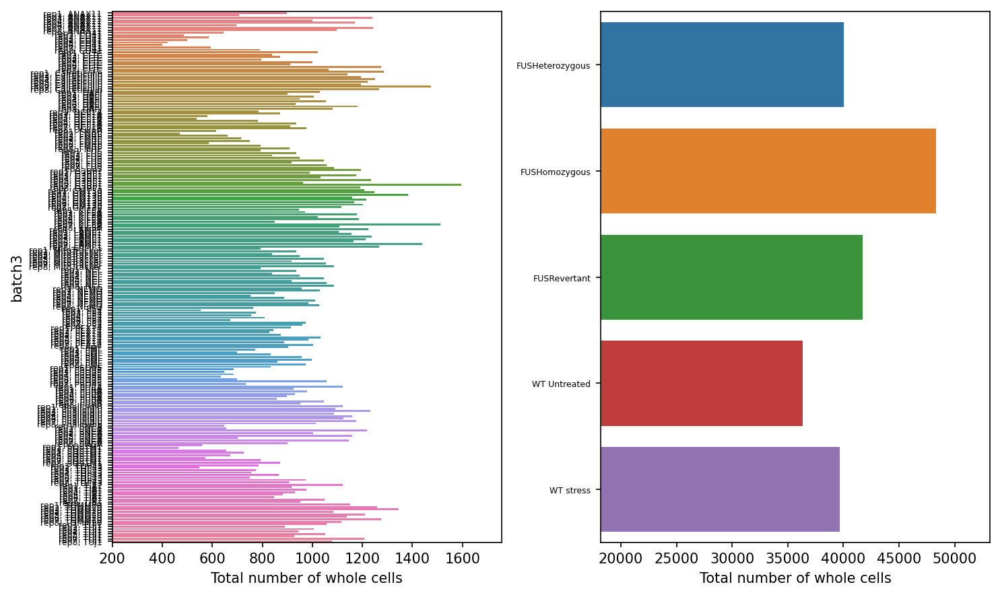

In [25]:
to_heatmap = total_sum.rename(columns={'site_whole_cells_counts_sum':'index'})
plot_filtering_heatmap(to_heatmap, extra_index='marker', vmin=None, vmax=None,
                      xlabel = 'Total number of whole cells', show_sum=True, figsize=(6,24))

### Show **Cell Count** Statistics per Batch

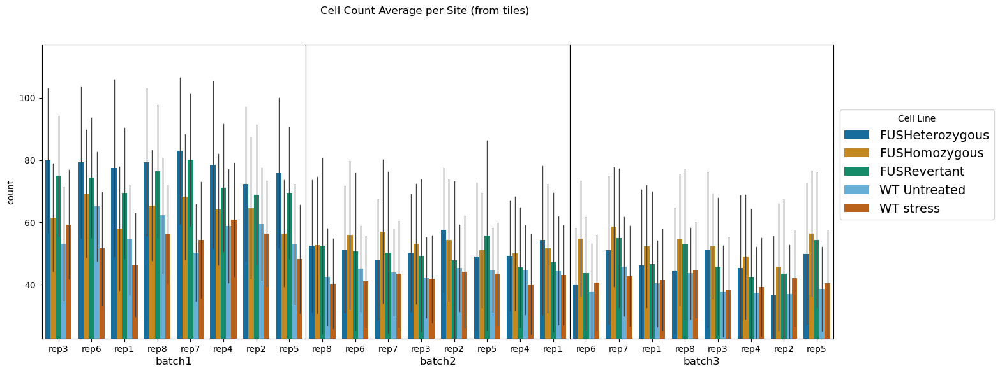

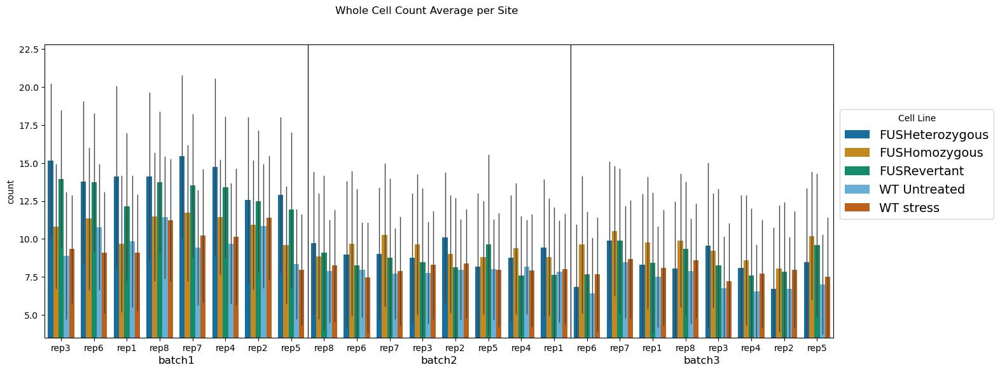

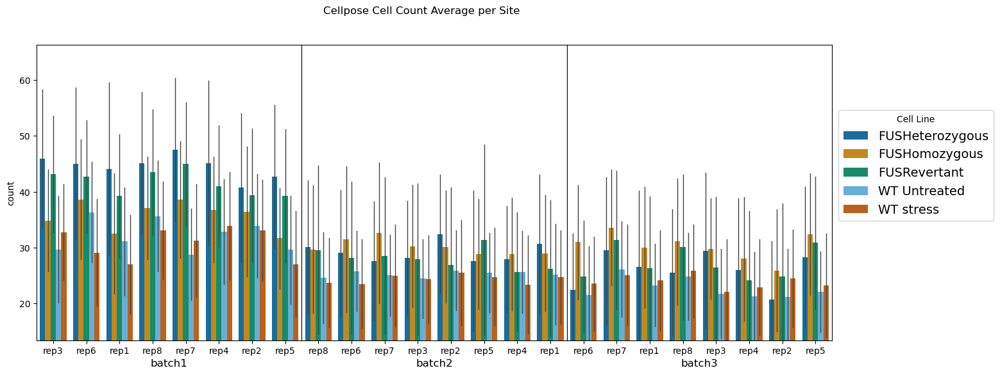

In [26]:
df_no_empty_sites = df_dapi[df_dapi.n_valid_tiles !=0]
plot_cell_count(df_no_empty_sites, lines_order, custom_palette, y='site_cell_count_sum', 
                title='Cell Count Average per Site (from tiles)', figsize=(16,6))

plot_cell_count(df_no_empty_sites, lines_order, custom_palette, y='site_whole_cells_counts_sum',
                title='Whole Cell Count Average per Site',figsize=(16,6))

plot_cell_count(df_no_empty_sites, lines_order, custom_palette, y='site_cell_count',
               title='Cellpose Cell Count Average per Site',figsize=(16,6))


### Show **Tiles** per Site Statistics


In [27]:
df_dapi.groupby(['cell_line_cond']).n_valid_tiles.mean()

cell_line_cond
FUSHeterozygous    9.213536
FUSHomozygous      8.819065
FUSRevertant       8.929758
WT Untreated       7.598508
WT stress          7.738811
Name: n_valid_tiles, dtype: float64

/home/labs/hornsteinlab/Collaboration/NOVA_GAL/NOVA/tools/preprocessing_tools/qc_reports/qc_utils.py:1020: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  else:
/home/labs/hornsteinlab/Collaboration/NOVA_GAL/NOVA/tools/preprocessing_tools/qc_reports/qc_utils.py:1031: UserWarning: The palette list has more values (10) than needed (8), which may not be intended.
  df=df.sort_values(by=hue)


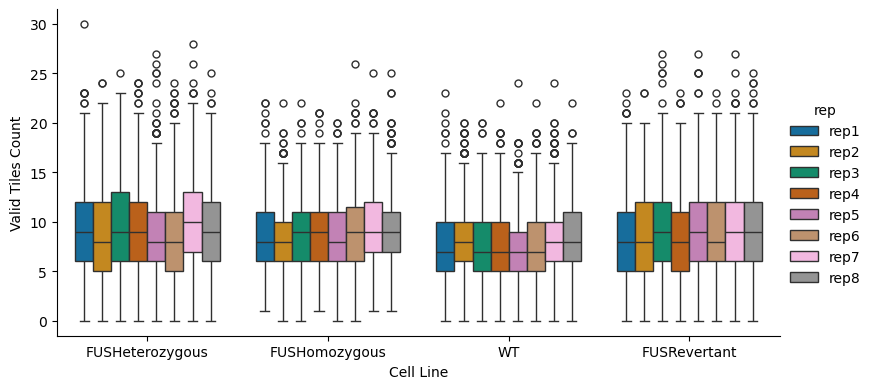

In [28]:
plot_catplot(df_dapi, sns.color_palette('colorblind'), reps=reps,x='cell_line', y_title='Valid Tiles Count', x_title='Cell Line', y='n_valid_tiles', hue='rep',
             height=4, aspect=2)


### Show Mean of cell count in valid tiles

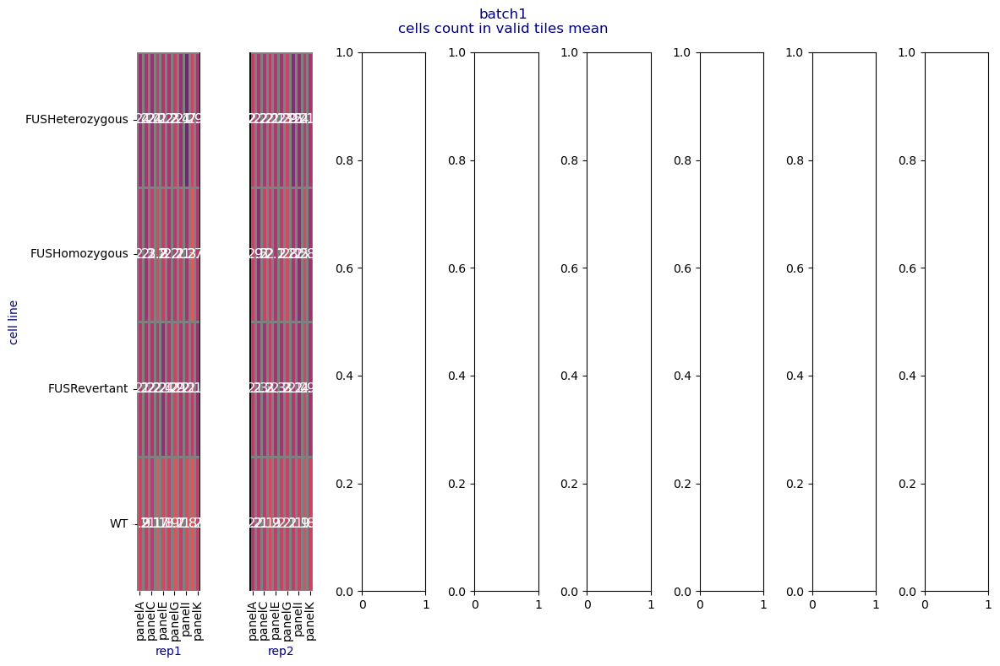

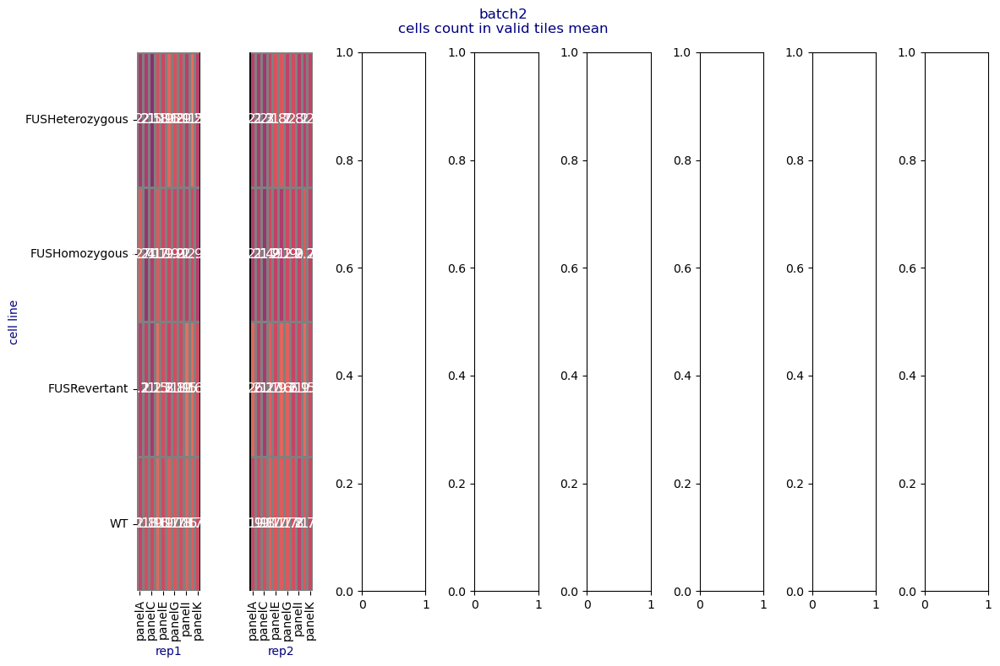

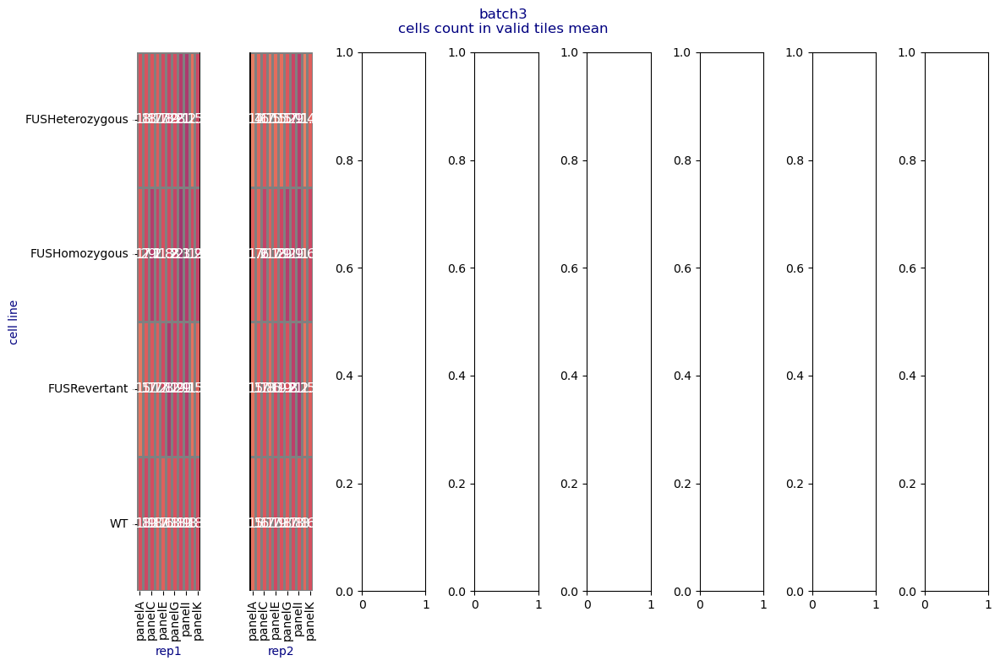

In [29]:
plot_hm(df_dapi, split_by='rep', rows='cell_line', columns='panel', vmax=3)

# Assessing Staining Reproducibility and Outliers

batch1


IndexError: index 1 is out of bounds for axis 0 with size 1

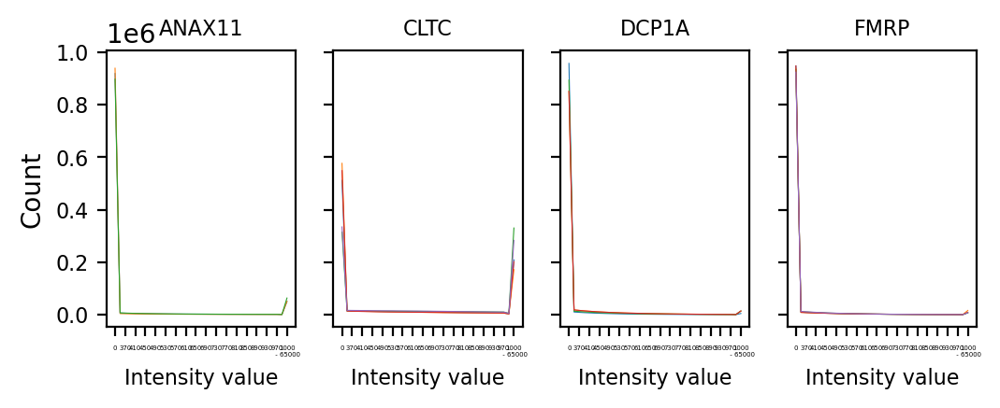

In [30]:
for batch in batches:
    print(batch)
    run_calc_hist_new(batch,cell_lines_for_disp, markers, root_directory_raw, root_directory_proc,
                           hist_sample=10,sample_size_per_markers=10, ncols=4, nrows=1, figsize=(6,2))
    print("="*30)
    

In [ ]:
# save notebook as HTML ( the HTML will be saved in the same folder the original script is)
display(Javascript('IPython.notebook.save_checkpoint();'))
os.system(f'jupyter nbconvert --to html tools/preprocessing_tools/qc_reports/qc_report_NIH_d8.ipynb --output {NOVA_HOME}/manuscript/preprocessing_qc_reports/qc_report_NIH_d8.html')